# Assignment 5 Group 6 - Henan Mu, Yixin Du, Xu Liu(Lexie)

## Some methods from movies-with-python-runme

Here, I write a function to use `PIL` to resize the image (`cv2.resize()`) and display the result:

In [133]:
from IPython.display import Image

In [58]:
from PIL import Image
import cv2 
from IPython.display import display

def imgcompress(path_in, path_out, k):
    img = cv2.imread(path_in, cv2.IMREAD_UNCHANGED)

    # set the ratio of resized image
    width = int((img.shape[1])/k)
    height = int((img.shape[0])/k)

    # resize the image by resize() function of openCV library
    scaled = cv2.resize(img, (width, height), interpolation=cv2.INTER_AREA)

    # get the resized image output by imwrite() function of openCV library
    cv2.imwrite(path_out, scaled)
    
    # display result
    imgc = cv2.imread(path_out, cv2.IMREAD_UNCHANGED)
    imgc_pil = cv2.cvtColor(imgc, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    display(Image.fromarray(imgc_pil))

Here I do the same thing without actually saving the picture:

In [59]:
def imgcompress_mem(path_in, k):
    img = cv2.imread(path_in, cv2.IMREAD_UNCHANGED)

    # set the ratio of resized image
    width = int((img.shape[1])/k)
    height = int((img.shape[0])/k)

    # resize the image by resize() function of openCV library
    return cv2.resize(img, (width, height), interpolation=cv2.INTER_AREA)

...and *that's* a drawing!

Here, I write functions: I use `cv2.cvtColor()` to convert to greyscale, then `cv2.medianBlur()` to blur the greyscale in order to remove details that are too fine, then `cv2.adaptiveThreshold()` to detect the edges of the shapes in the image, then `cv2.bitwise_and()` to **bitblt** (superimpose) the original image with its edges:

In [60]:
def cartoonize(path_in, path_out, k):
    
    imgcompress(path_in, path_out, k)
    imgc = cv2.imread(path_out, cv2.IMREAD_UNCHANGED)
    imgc_pil = cv2.cvtColor(imgc, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

    line_size = 3
    blur_value = 7
    gray = cv2.cvtColor(imgc, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.medianBlur(gray, blur_value)
    bigedges = cv2.adaptiveThreshold(gray_blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, line_size, blur_value)
    bigedges_pil = cv2.cvtColor(bigedges, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

    cartoon = cv2.bitwise_and(imgc, imgc, mask=bigedges)
    cartoon_pil = cv2.cvtColor(cartoon, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    display(Image.fromarray(cartoon_pil))

Here I also control the blur amount and the width of the borders of the shapes in the image, with the `blur` and `line` parameters:

In [61]:
# Controls blur amount and line size
def cartoonizebl_mem(path_in, k, blur, line):
    
    imgc = imgcompress_mem(path_in, k)
    #imgc_pil = cv2.cvtColor(imgc, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    #display(Image.fromarray(imgc_pil))

    line_size = line
    blur_value = blur
    #imgc = cv2.imread(path_out, cv2.IMREAD_UNCHANGED)
    gray = cv2.cvtColor(imgc, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.medianBlur(gray, blur_value)
    bigedges = cv2.adaptiveThreshold(gray_blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, line_size, blur_value)
    bigedges_pil = cv2.cvtColor(bigedges, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    #display(Image.fromarray(bigedges_pil))

    return cv2.bitwise_and(imgc, imgc, mask=bigedges)

Here's an example of how to *programmatically* add multi-line text to the image:

In [62]:
import numpy as np
import pandas as pd
from fpdf import FPDF
from PIL import Image as pili, ImageDraw as pild, ImageFont as pilf, ImageOps as piliops

TINT_COLOR = (0, 0, 0)  # Black
OPACITY = int(255 * .50)
FONT = pilf.truetype("Inkfree.ttf", 24) # Font
IMG_BASE_WIDTH = 600
IMG_NUMBERS = 47

def convert_from_cv2_to_image(img: np.ndarray) -> pili:
    return Image.fromarray(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    #return pili.fromarray(img)

def convert_from_image_to_cv2(img: pili) -> np.ndarray:
    return cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    #return np.asarray(img)

In [63]:
# Controls blur amount and line size and number of text lines. No bold font!
def cartoonizeblt_mem_nb(path_in, k, blur, line, text, nlines=1, font='verdana'):
    
    print(path_in)
    imgc = imgcompress_mem(path_in, k)

    line_size = line
    blur_value = blur
    gray = cv2.cvtColor(imgc, cv2.COLOR_BGR2GRAY)
    gray_blur = cv2.medianBlur(gray, blur_value)
    bigedges = cv2.adaptiveThreshold(gray_blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, line_size, blur_value)
    bigedges_pil = cv2.cvtColor(bigedges, cv2.COLOR_BGR2RGB) # Converting BGR to RGB

    toon = cv2.bitwise_and(imgc, imgc, mask=bigedges)
    if 0 == len(text):
        return toon
    
    print('Using font ' + font + '...')
    myfont = (
        pilf.truetype("ITCKRIST.TTF", 
            24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 82) if font=='ITCKRIST'
        else
            pilf.truetype("Inkfree.ttf", 
                24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 82) if font=='Inkfree'
        else
            pilf.truetype(font + ".ttf", 24 if k == 16 else 18 if k == 14 else 18 if k == 12 else 20 if k == 8 else 82)
    )


    cblimg_pil = Image.fromarray(cv2.cvtColor(toon, cv2.COLOR_BGR2RGBA))

    overlay = pili.new('RGBA', cblimg_pil.size, TINT_COLOR+(0,))
    draw = pild.Draw(overlay)
    #_, h = FONT.getsize(text)
    _, h = myfont.getsize(text)
    num_lines = nlines
    x, y = 0, cblimg_pil.height - (num_lines)*h-10
    draw.rectangle((x, y, x + cblimg_pil.width, y + (num_lines)*h+10), fill=TINT_COLOR+(OPACITY,))
    if k == 1:
        draw.text((x+10, y), text, fill=(255, 255, 255), font=myfont) #, stroke_width=1)
    elif k < 8:
        draw.text((x+10, y), text, fill=(255, 255, 255), font=myfont)
    else:
        draw.text((x+10, y), text, fill=(0, 255, 0), font=myfont) #, stroke_width=1)

    cblimg_pil = pili.alpha_composite(cblimg_pil, overlay)
    cblimg_pil = cblimg_pil.convert("RGB")

    return convert_from_image_to_cv2(cblimg_pil)

# Our work

To make simple_row function stable when dealing with different numbers and sizes of images, we rewritted the function and named it my_simple_row. It can be used to concatenate several images horizontally.

In [64]:
def my_simple_row(folder, list_im, list_opt, list_txt, list_nlines, font='arial'):
    
    # cartoonize them in memory with text
    cimgs = [ cartoonizeblt_mem_nb(folder + '/' + i + '.JPG', 14, 3, 3, k, nlines=n, font=font)
              for i,j,k,n in zip(list_im, list_opt, list_txt, list_nlines) ]
    
    # resize
    heighto = int(cimgs[0].shape[0])
    widtho = int(cimgs[0].shape[1])
    # heighto / widtho = height / width ==> height = heighto / widtho * width
    width = 245
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [ cv2.resize(cimgs[i], cimgs_dim, interpolation = cv2.INTER_AREA) for i in range(len(list_im))]

    # add borders
    white = [255,255,255]
    bcimgs = [ cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=white) for i in cimgsr ]

    # stack them horizontally
    return np.concatenate([ bcimgs[i] for i in range(0,len(list_im)) ], axis=1)

This method *my_simple_row_chinese* is same like my_simple_row, but this method is for chinese.

In [65]:
def my_simple_row_chinese(folder, list_im, list_opt, list_txt, list_nlines, font='dengl'):
    
    # cartoonize them in memory with text
    cimgs = [ cartoonizeblt_mem_nb(folder + '/' + i + '.JPG', 14, 3, 3, k, nlines=n, font=font)
              for i,j,k,n in zip(list_im, list_opt, list_txt, list_nlines) ]
    
    # resize
    heighto = int(cimgs[0].shape[0])
    widtho = int(cimgs[0].shape[1])
    # heighto / widtho = height / width ==> height = heighto / widtho * width
    width = 245
    height = int(heighto / widtho * width)
    cimgs_dim = (width, height)
    cimgsr = [ cv2.resize(cimgs[i], cimgs_dim, interpolation = cv2.INTER_AREA) for i in range(len(list_im))]

    # add borders
    white = [255,255,255]
    bcimgs = [ cv2.copyMakeBorder(i, 5, 5, 5, 5, cv2.BORDER_CONSTANT, value=white) for i in cimgsr ]

    # stack them horizontally
    return np.concatenate([ bcimgs[i] for i in range(0,len(list_im)) ], axis=1)

In [152]:
from PIL import Image

In [153]:
import PIL

## Page 1

For the first page

group6_images/coach.JPG
Using font arial...
group6_images/flower.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/man.JPG
Using font arial...
group6_images/house.JPG
Using font arial...
group6_images/meat.JPG
Using font arial...


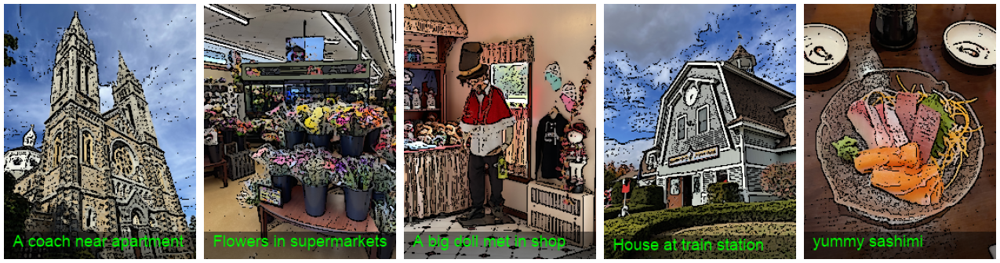

In [154]:
rows_5 = my_simple_row (
        'group6_images', 
         ['coach', 'flower', 'man', 'house', 'meat'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['A coach near apartment', 'Flowers in supermarkets', 'A big doll met in shop', 'House at train station', 'yummy sashimi'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('1-row5-1.png')

group6_images/spiderman1.JPG
Using font arial...
group6_images/spiderman2.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/IMG_5682.JPG
Using font arial...
group6_images/IMG_5684.JPG
Using font arial...
group6_images/IMG_5712.JPG
Using font arial...


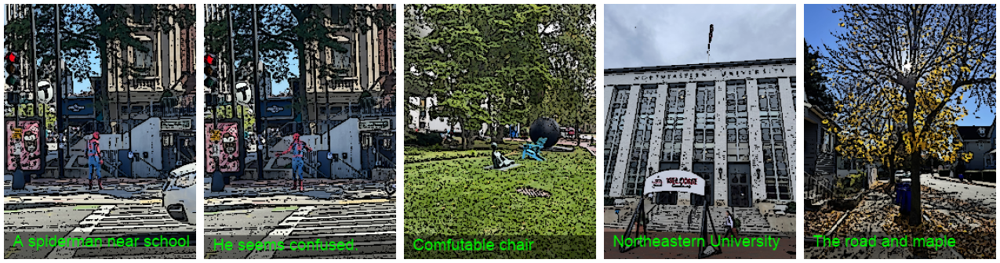

In [155]:
rows_5 = my_simple_row (
        'group6_images', 
         ['spiderman1', 'spiderman2', 'IMG_5682', 'IMG_5684', 'IMG_5712'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['A spiderman near school', 'He seems confused.', 'Comfutable chair', 'Northeastern University', 'The road and maple'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('1-row5-2.png')

group6_images/train.JPG
Using font arial...
group6_images/sky.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/mountain.JPG
Using font arial...
group6_images/mounlake.JPG
Using font arial...


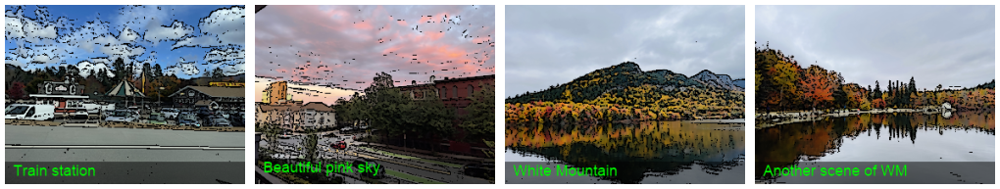

In [156]:
rows_4 = my_simple_row (
        'group6_images', 
         ['train', 'sky', 'mountain', 'mounlake'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['Train station', 'Beautiful pink sky', 'White Mountain', 'Another scene of WM'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('1-row4-1.png')

group6_images/IMG_5515.JPG
Using font arial...
group6_images/IMG_5574.JPG
Using font arial...
group6_images/IMG_5679.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/IMG_5716.JPG
Using font arial...


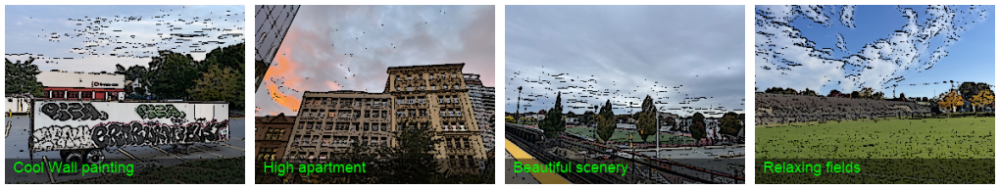

In [157]:
rows_4 = my_simple_row (
        'group6_images', 
         ['IMG_5515', 'IMG_5574', 'IMG_5679', 'IMG_5716'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['Cool Wall painting', 'High apartment', 'Beautiful scenery', 'Relaxing fields'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('1-row4-2.png')

group6_images/lake.JPG
Using font arial...
group6_images/light.JPG
Using font arial...
group6_images/littledove.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...


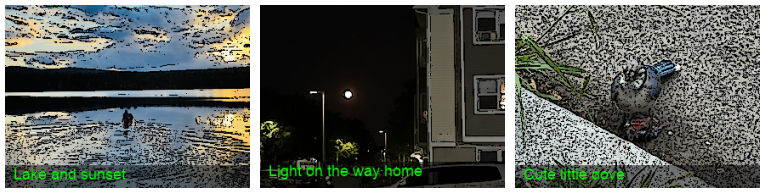

In [158]:
rows_3 = my_simple_row (
        'group6_images', 
         ['lake', 'light', 'littledove'],
         ['pencil', 'pencil', 'buildings'],
         ['Lake and sunset', 'Light on the way home', 'Cute little dove'],
         [1, 1, 1]
        )
rows_3_pil = cv2.cvtColor(rows_3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_3_pil))
rows_3_pil.shape
PIL.Image.fromarray(rows_3_pil).save('1-row3-1.png')

Following is a big part of our code, we rewrite the algorithm of vertical strip. We scale all other large images equally by using the size and scale of the smallest image.

For an example, min is the smallest image and the image1 is bigger than min. So we need to scale image1.

$$ newImage1.width = min.width $$

$$ newImage1.height = \frac{min.width}{image1.width} * image1.height $$

/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/2676042238.py:11: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )


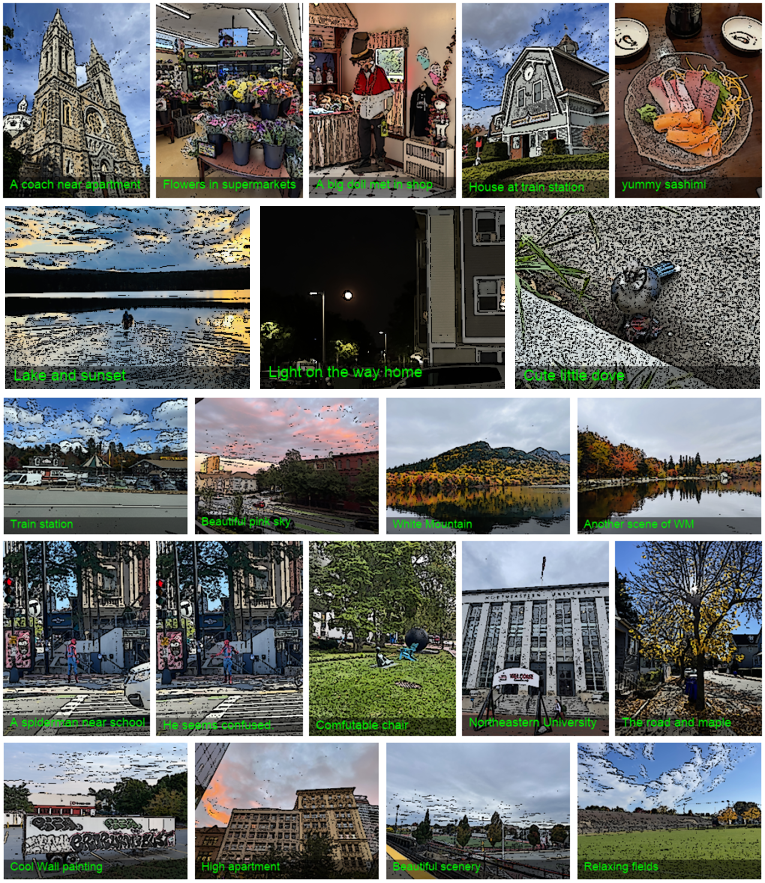

In [159]:
list_im = ['1-row5-1.png',
            '1-row3-1.png',
          '1-row4-1.png',
          '1-row5-2.png',
          '1-row4-2.png']
imgs    = [ PIL.Image.open(i) for i in list_im ]

# pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted( [(np.sum(i.size), i.size ) for i in imgs])[0][1]
shapes = [[min_shape[0], (int)((min_shape[0] / i.size[0]) * i.size[1])] for i in imgs]
imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )

# save that beautiful picture
imgs_comb = PIL.Image.fromarray( imgs_comb)
imgs_comb.save( 'page1.png' ) 
imgs_comb

group6_images/coach.JPG
Using font dengl...
group6_images/flower.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/man.JPG
Using font dengl...
group6_images/house.JPG
Using font dengl...
group6_images/meat.JPG
Using font dengl...


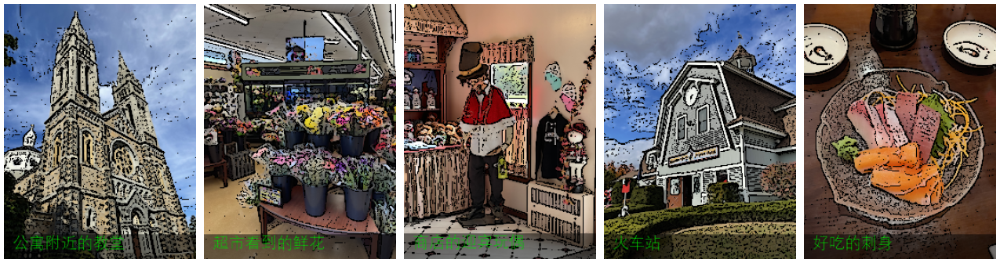

In [160]:
rows_5 = my_simple_row_chinese (
        'group6_images', 
         ['coach', 'flower', 'man', 'house', 'meat'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['公寓附近的教堂', '超市看到的鲜花', '商店的迎宾玩偶', '火车站', '好吃的刺身'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('1-row5-1-c.png')

group6_images/spiderman1.JPG
Using font dengl...
group6_images/spiderman2.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/IMG_5682.JPG
Using font dengl...
group6_images/IMG_5684.JPG
Using font dengl...
group6_images/IMG_5712.JPG
Using font dengl...


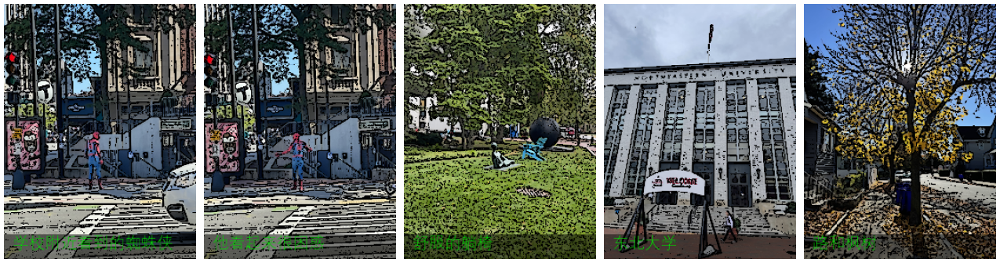

In [161]:
rows_5 = my_simple_row_chinese (
        'group6_images', 
         ['spiderman1', 'spiderman2', 'IMG_5682', 'IMG_5684', 'IMG_5712'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['学校附近看到的蜘蛛侠', '他看起来很困惑', '舒服的躺椅', '东北大学', '路和枫树'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('1-row5-2-c.png')

group6_images/train.JPG
Using font dengl...
group6_images/sky.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/mountain.JPG
Using font dengl...
group6_images/mounlake.JPG
Using font dengl...


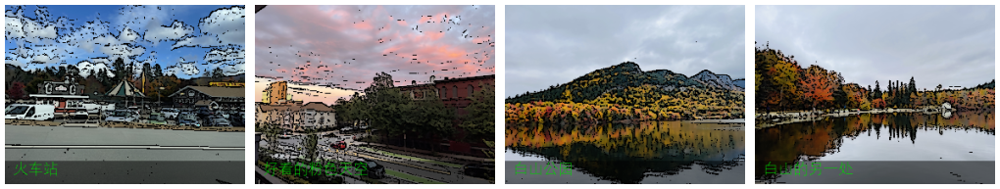

In [162]:
rows_4 = my_simple_row_chinese (
        'group6_images', 
         ['train', 'sky', 'mountain', 'mounlake'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['火车站', '好看的粉色天空', '白山公园', '白山的另一处'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('1-row4-1-c.png')

group6_images/IMG_5515.JPG
Using font dengl...
group6_images/IMG_5574.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/IMG_5679.JPG
Using font dengl...
group6_images/IMG_5716.JPG
Using font dengl...


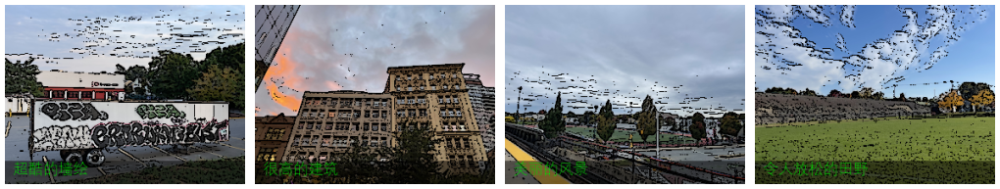

In [163]:
rows_4 = my_simple_row_chinese (
        'group6_images', 
         ['IMG_5515', 'IMG_5574', 'IMG_5679', 'IMG_5716'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['超酷的墙绘', '很高的建筑', '美丽的风景', '令人放松的田野'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('1-row4-2-c.png')

group6_images/lake.JPG
Using font dengl...
group6_images/light.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/littledove.JPG
Using font dengl...


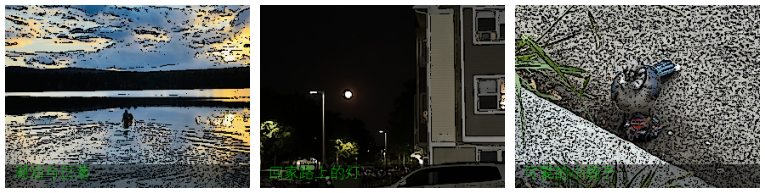

In [164]:
rows_3 = my_simple_row_chinese (
        'group6_images', 
         ['lake', 'light', 'littledove'],
         ['pencil', 'pencil', 'buildings'],
         ['湖泊与日落', '回家路上的灯', '可爱的小鸽子'],
         [1, 1, 1]
        )
rows_3_pil = cv2.cvtColor(rows_3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_3_pil))
rows_3_pil.shape
PIL.Image.fromarray(rows_3_pil).save('1-row3-1-c.png')

/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/113900024.py:11: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )


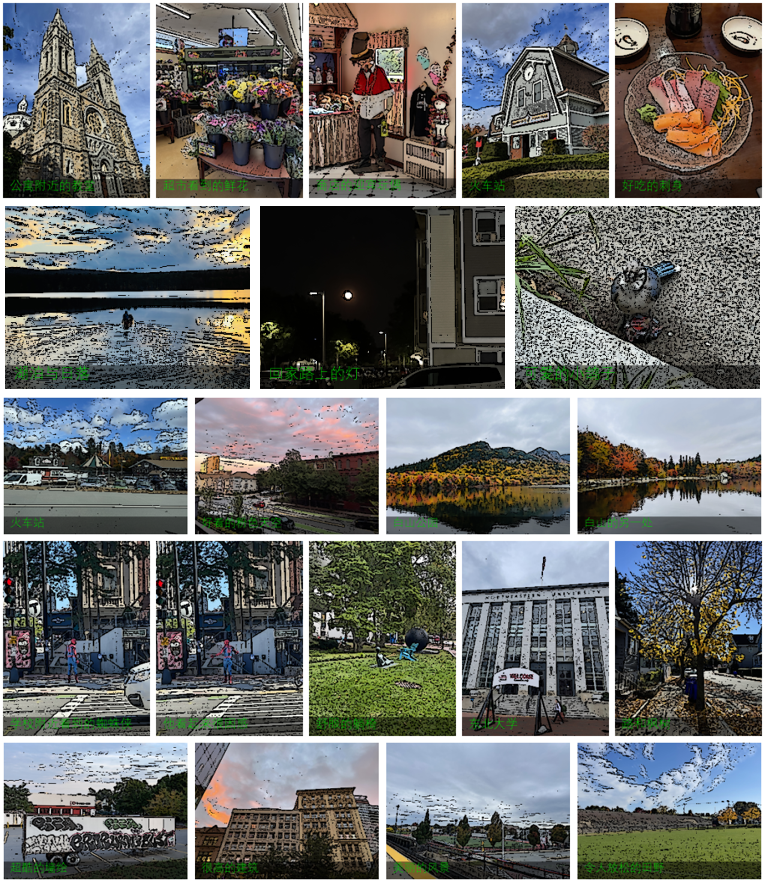

In [165]:
list_im = ['1-row5-1-c.png',
            '1-row3-1-c.png',
          '1-row4-1-c.png',
          '1-row5-2-c.png',
          '1-row4-2-c.png']
imgs    = [ PIL.Image.open(i) for i in list_im ]

# pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted( [(np.sum(i.size), i.size ) for i in imgs])[0][1]
shapes = [[min_shape[0], (int)((min_shape[0] / i.size[0]) * i.size[1])] for i in imgs]
imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )

# save that beautiful picture
imgs_comb = PIL.Image.fromarray( imgs_comb)
imgs_comb.save( 'page1-c.png' ) 
imgs_comb

## Page 2

In [75]:
from PIL import Image
import PIL

group6_images/page2/IMG_5665.JPG
Using font arial...
group6_images/page2/IMG_5578.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/page2/IMG_5576.JPG
Using font arial...
group6_images/page2/IMG_5527.JPG
Using font arial...
group6_images/page2/IMG_5520.JPG
Using font arial...


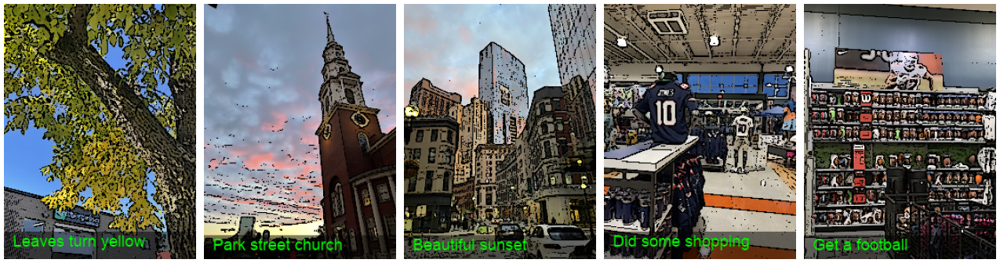

In [102]:
rows_5 = my_simple_row (
        'group6_images/page2', 
         ['IMG_5665', 'IMG_5578', 'IMG_5576', 'IMG_5527', 'IMG_5520'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['Leaves turn yellow', 'Park street church', 'Beautiful sunset', 'Did some shopping', 'Get a football'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('2-row5-1.png')

group6_images/page2/IMG_5665.JPG
Using font dengl...
group6_images/page2/IMG_5578.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/page2/IMG_5576.JPG
Using font dengl...
group6_images/page2/IMG_5527.JPG
Using font dengl...
group6_images/page2/IMG_5520.JPG
Using font dengl...


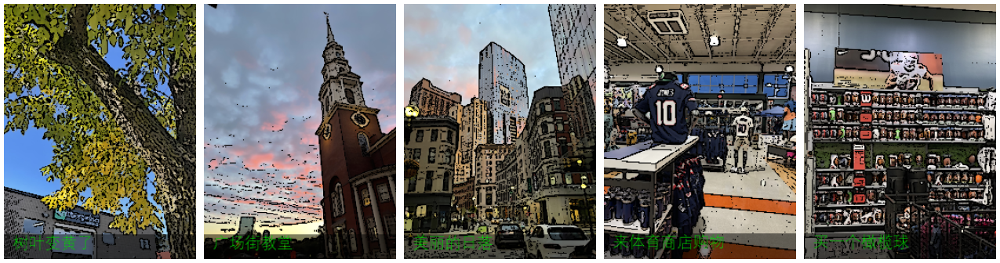

In [126]:
rows_5 = my_simple_row_chinese (
        'group6_images/page2', 
         ['IMG_5665', 'IMG_5578', 'IMG_5576', 'IMG_5527', 'IMG_5520'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['树叶变黄了', '广场街教堂', '美丽的日落', '来体育商店购物', '买一个橄榄球'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('2-row5-1-c.png')

group6_images/page2/IMG_5501.JPG
Using font arial...
group6_images/page2/IMG_5436.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/page2/IMG_5433.JPG
Using font arial...
group6_images/page2/IMG_5432.JPG
Using font arial...
group6_images/page2/IMG_5422.JPG
Using font arial...


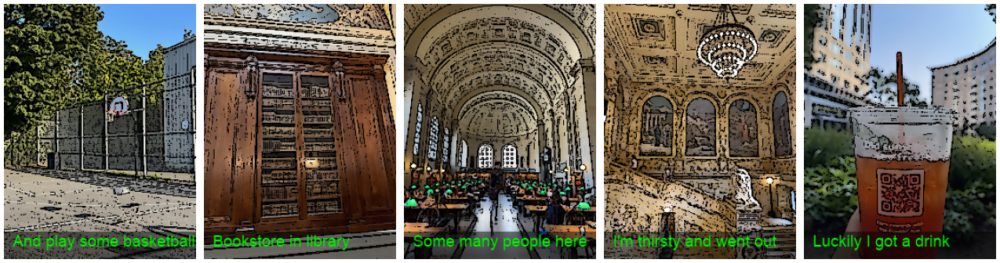

In [107]:
rows_5 = my_simple_row (
        'group6_images/page2', 
         ['IMG_5501', 'IMG_5436', 'IMG_5433', 'IMG_5432', 'IMG_5422'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['And play some basketball', 'Bookstore in library', 'Some many people here', 'I\'m thirsty and went out', 'Luckily I got a drink'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('2-row5-2.png')

group6_images/page2/IMG_5501.JPG
Using font dengl...
group6_images/page2/IMG_5436.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/page2/IMG_5433.JPG
Using font dengl...
group6_images/page2/IMG_5432.JPG
Using font dengl...
group6_images/page2/IMG_5422.JPG
Using font dengl...


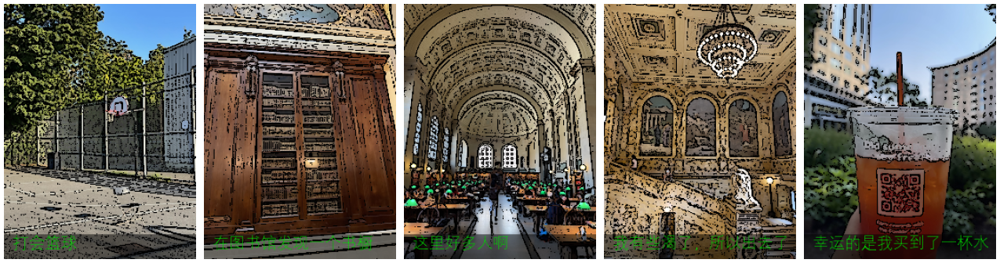

In [127]:
rows_5 = my_simple_row_chinese (
        'group6_images/page2', 
         ['IMG_5501', 'IMG_5436', 'IMG_5433', 'IMG_5432', 'IMG_5422'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['打会篮球', '在图书馆发现一个书橱', '这里好多人啊', '我有些渴了，所以出去了', '幸运的是我买到了一杯水'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('2-row5-2-c.png')

group6_images/page2/IMG_5417.JPG
Using font arial...
group6_images/page2/IMG_5474.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/page2/IMG_5445.JPG
Using font arial...
group6_images/page2/IMG_5425.JPG
Using font arial...


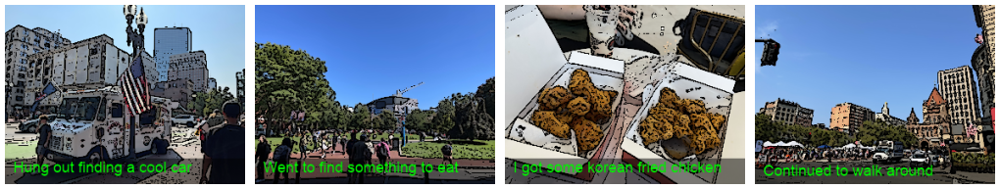

In [112]:
rows_4 = my_simple_row (
        'group6_images/page2', 
         ['IMG_5417', 'IMG_5474', 'IMG_5445', 'IMG_5425'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['Hung out finding a cool car', 'Went to find something to eat', 'I got some korean fried chicken', 'Continued to walk around'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('2-row4-1.png')

group6_images/page2/IMG_5417.JPG
Using font dengl...
group6_images/page2/IMG_5474.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/page2/IMG_5445.JPG
Using font dengl...
group6_images/page2/IMG_5425.JPG
Using font dengl...


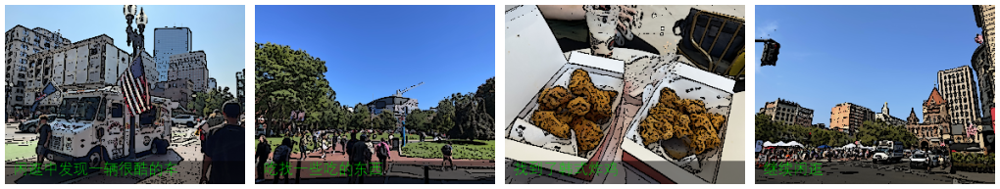

In [128]:
rows_4 = my_simple_row_chinese (
        'group6_images/page2', 
         ['IMG_5417', 'IMG_5474', 'IMG_5445', 'IMG_5425'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['闲逛中发现一辆很酷的车', '吃找一些吃的东西', '找到了韩式炸鸡', '继续闲逛'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('2-row4-1-c.png')

group6_images/page2/IMG_5416.JPG
Using font arial...
group6_images/page2/IMG_5414.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/page2/IMG_5401.JPG
Using font arial...
group6_images/page2/IMG_5396.JPG
Using font arial...


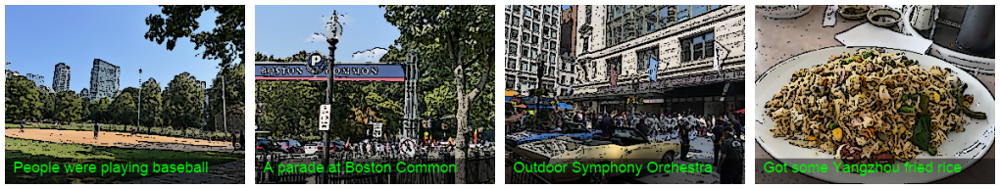

In [118]:
rows_4 = my_simple_row (
        'group6_images/page2', 
         ['IMG_5416', 'IMG_5414', 'IMG_5401', 'IMG_5396'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['People were playing baseball', 'A parade at Boston Common', 'Outdoor Symphony Orchestra', 'Got some Yangzhou fried rice'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('2-row4-2.png')

group6_images/page2/IMG_5416.JPG
Using font dengl...
group6_images/page2/IMG_5414.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/page2/IMG_5401.JPG
Using font dengl...
group6_images/page2/IMG_5396.JPG
Using font dengl...


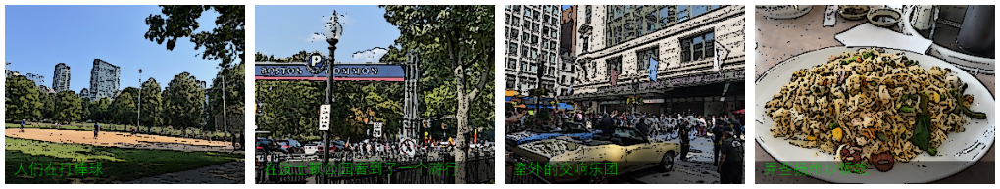

In [129]:
rows_4 = my_simple_row_chinese (
        'group6_images/page2', 
         ['IMG_5416', 'IMG_5414', 'IMG_5401', 'IMG_5396'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['人们在打棒球', '在波士顿公园看到了一个游行', '室外的交响乐团', '弄些扬州炒饭吃'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('2-row4-2-c.png')

group6_images/page2/IMG_5384.JPG
Using font arial...
group6_images/page2/IMG_5369.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/page2/IMG_5367.JPG
Using font arial...


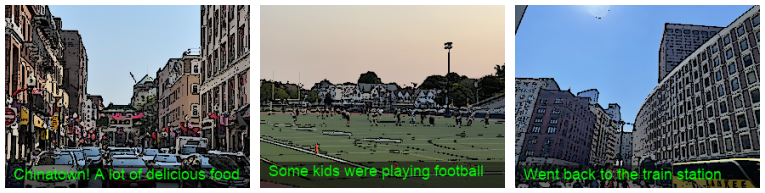

In [130]:
rows_3 = my_simple_row (
        'group6_images/page2', 
         ['IMG_5384', 'IMG_5369', 'IMG_5367'],
         ['pencil', 'pencil', 'buildings'],
         ['Chinatown! A lot of delicious food', 'Some kids were playing football', 'Went back to the train station'],
         [1, 1, 1]
        )
rows_3_pil = cv2.cvtColor(rows_3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_3_pil))
rows_3_pil.shape
PIL.Image.fromarray(rows_3_pil).save('2-row3-1.png')

group6_images/page2/IMG_5384.JPG
Using font dengl...


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


group6_images/page2/IMG_5369.JPG
Using font dengl...
group6_images/page2/IMG_5367.JPG
Using font dengl...


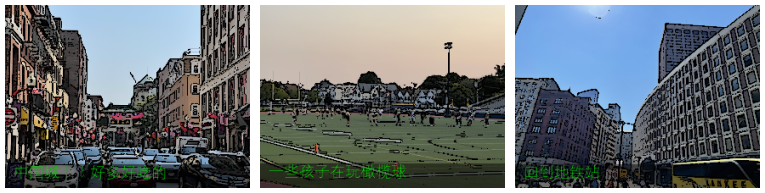

In [131]:
rows_3 = my_simple_row_chinese (
        'group6_images/page2', 
         ['IMG_5384', 'IMG_5369', 'IMG_5367'],
         ['pencil', 'pencil', 'buildings'],
         ['中国城！！好多好吃的', '一些孩子在玩橄榄球', '回到地铁站'],
         [1, 1, 1]
        )
rows_3_pil = cv2.cvtColor(rows_3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_3_pil))
rows_3_pil.shape
PIL.Image.fromarray(rows_3_pil).save('2-row3-1-c.png')

/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/181247220.py:9: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )


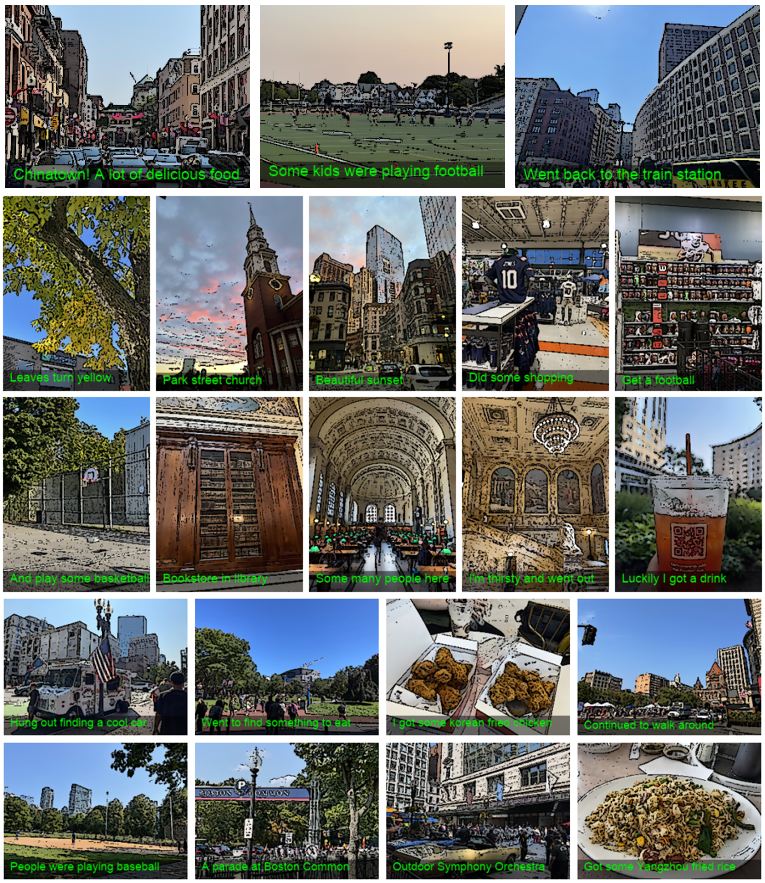

In [124]:
list_im = ['2-row3-1.png','2-row5-1.png',
           '2-row5-2.png','2-row4-1.png',
          '2-row4-2.png']
imgs    = [ PIL.Image.open(i) for i in list_im ]

# pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted( [(np.sum(i.size), i.size ) for i in imgs])[0][1]
shapes = [[min_shape[0], (int)((min_shape[0] / i.size[0]) * i.size[1])] for i in imgs]
imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )

# save that beautiful picture
imgs_comb = PIL.Image.fromarray( imgs_comb)
imgs_comb.save( 'page2.png' ) 
imgs_comb

/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1184984016.py:9: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )


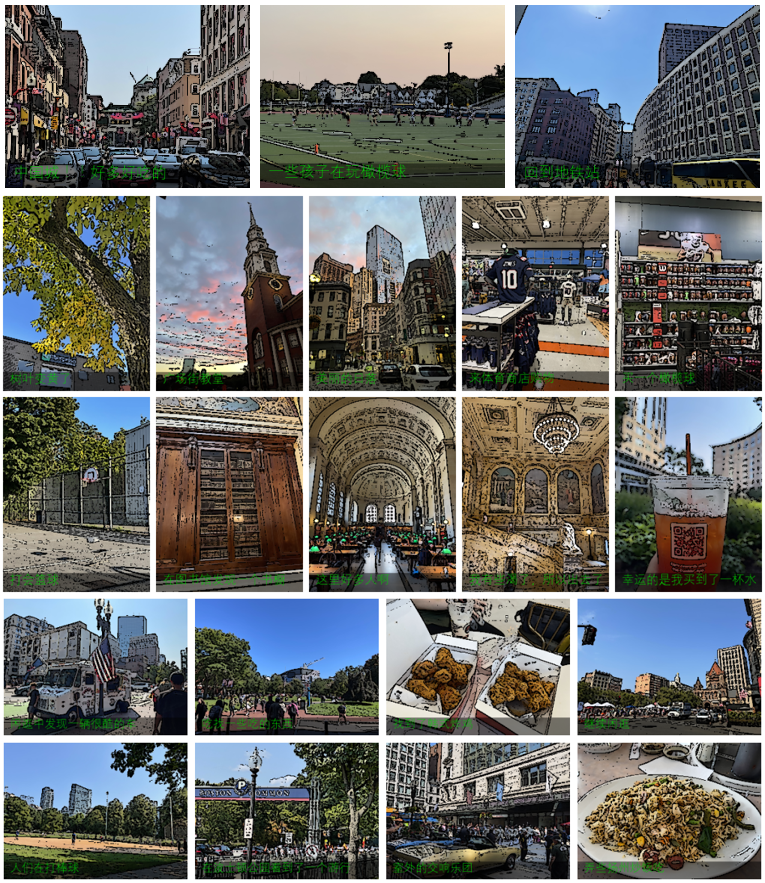

In [132]:
list_im = ['2-row3-1-c.png','2-row5-1-c.png',
           '2-row5-2-c.png','2-row4-1-c.png',
          '2-row4-2-c.png']
imgs    = [ PIL.Image.open(i) for i in list_im ]

# pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted( [(np.sum(i.size), i.size ) for i in imgs])[0][1]
shapes = [[min_shape[0], (int)((min_shape[0] / i.size[0]) * i.size[1])] for i in imgs]
imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )

# save that beautiful picture
imgs_comb = PIL.Image.fromarray( imgs_comb)
imgs_comb.save( 'page2-c.png' ) 
imgs_comb

## Page 3

In [166]:
from PIL import Image
import PIL

group6_images/page3/Food4.JPG
Using font arial...
group6_images/page3/noodle1.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/page3/wanzi.JPG
Using font arial...
group6_images/page3/pancake.JPG
Using font arial...
group6_images/page3/pho.JPG
Using font arial...


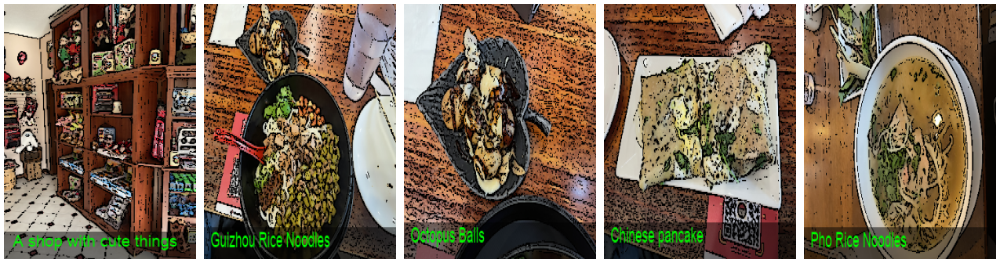

In [167]:
rows_5 = my_simple_row (
        'group6_images/page3', 
         ['Food4', 'noodle1', 'wanzi', 'pancake', 'pho'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['A shop with cute things', 'Guizhou Rice Noodles', 'Octopus Balls', 'Chinese pancake', 'Pho Rice Noodles'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('3-row5-1.png')

group6_images/page3/BoatTogether.JPG
Using font arial...
group6_images/page3/CanadaGoose.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/page3/CharlesRive.JPG
Using font arial...
group6_images/page3/ManSittingInPublicGarden.JPG
Using font arial...
group6_images/page3/Paiting.JPG
Using font arial...


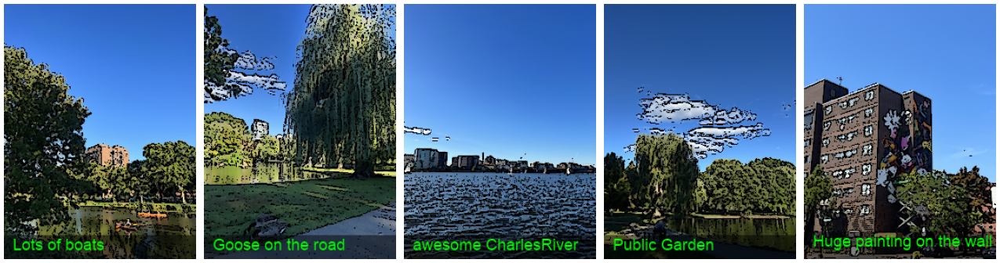

In [168]:
rows_5 = my_simple_row (
        'group6_images/page3', 
         ['BoatTogether', 'CanadaGoose', 'CharlesRive', 'ManSittingInPublicGarden', 'Paiting'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['Lots of boats', 'Goose on the road', 'awesome CharlesRiver', 'Public Garden', 'Huge painting on the wall'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('3-row5-2.png')

group6_images/page3/airport.JPG
Using font arial...
group6_images/page3/airsky.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/page3/BostonPublicLiabray.JPG
Using font arial...
group6_images/page3/building.JPG
Using font arial...


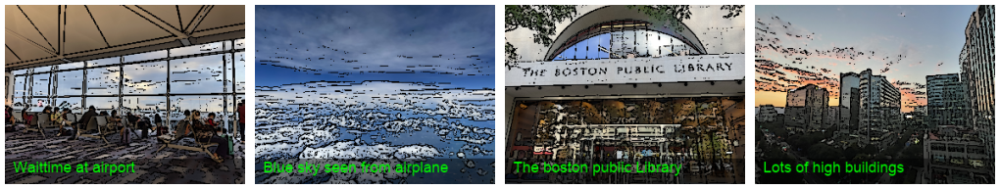

In [169]:
rows_4 = my_simple_row (
        'group6_images/page3', 
         ['airport', 'airsky', 'BostonPublicLiabray', 'building'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['Waittime at airport', 'Blue sky seen from airplane', 'The boston public Library', 'Lots of high buildings'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('3-row4-1.png')

group6_images/page3/sunlight.JPG
Using font arial...
group6_images/page3/target.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/page3/IMG_5345.JPG
Using font arial...
group6_images/page3/IMG_5349.JPG
Using font arial...


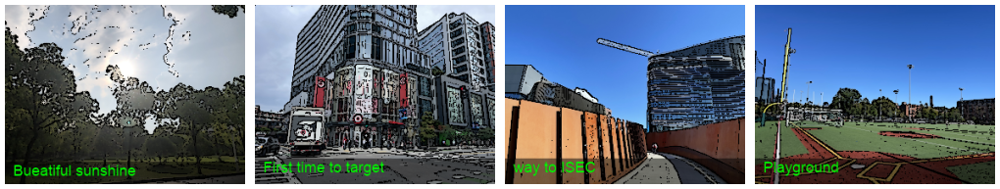

In [170]:
rows_4 = my_simple_row (
        'group6_images/page3', 
         ['sunlight', 'target', 'IMG_5345', 'IMG_5349'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['Bueatiful sunshine', 'First time to target', 'way to ISEC', 'Playground'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('3-row4-2.png')

group6_images/page3/IMG_5340.JPG
Using font arial...
group6_images/page3/IMG_5328.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font arial...
group6_images/page3/IMG_5236.JPG
Using font arial...


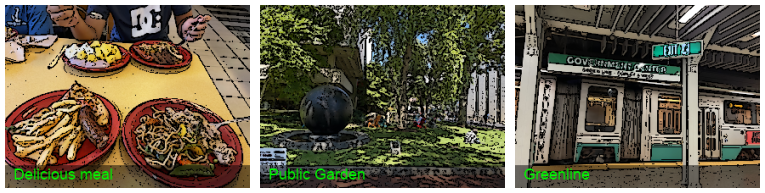

In [171]:
rows_3 = my_simple_row (
        'group6_images/page3', 
         ['IMG_5340', 'IMG_5328', 'IMG_5236'],
         ['pencil', 'pencil', 'buildings'],
         ['Delicious meal', 'Public Garden', 'Greenline'],
         [1, 1, 1]
        )
rows_3_pil = cv2.cvtColor(rows_3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_3_pil))
rows_3_pil.shape
PIL.Image.fromarray(rows_3_pil).save('3-row3-1.png')

/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/445920964.py:9: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )


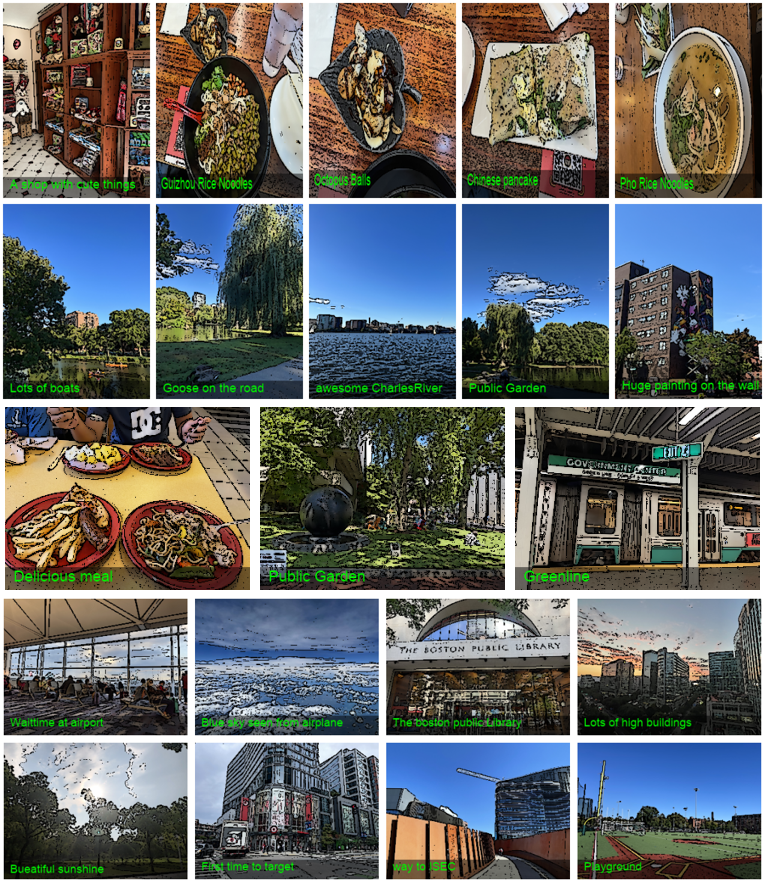

In [172]:
list_im = ['3-row5-1.png',
           '3-row5-2.png','3-row3-1.png','3-row4-1.png',
          '3-row4-2.png']
imgs    = [ PIL.Image.open(i) for i in list_im ]

# pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted( [(np.sum(i.size), i.size ) for i in imgs])[0][1]
shapes = [[min_shape[0], (int)((min_shape[0] / i.size[0]) * i.size[1])] for i in imgs]
imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )

# save that beautiful picture
imgs_comb = PIL.Image.fromarray( imgs_comb)
imgs_comb.save( 'page3.png' ) 
imgs_comb

group6_images/page3/Food4.JPG
Using font dengl...
group6_images/page3/noodle1.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/page3/wanzi.JPG
Using font dengl...
group6_images/page3/pancake.JPG
Using font dengl...
group6_images/page3/pho.JPG
Using font dengl...


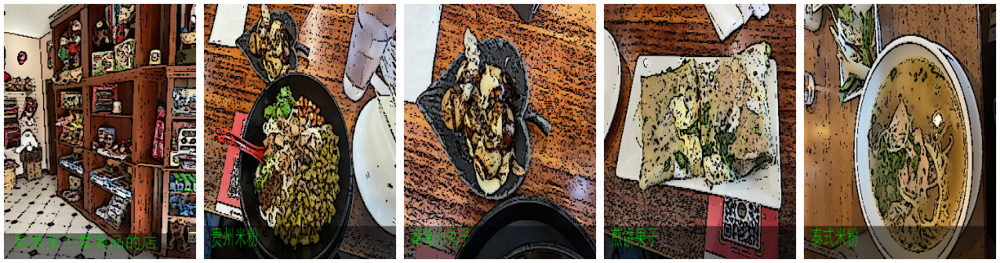

In [173]:
rows_5 = my_simple_row_chinese (
        'group6_images/page3', 
         ['Food4', 'noodle1', 'wanzi', 'pancake', 'pho'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['有很多可爱商品的店', '贵州米粉', '章鱼小丸子', '煎饼果子', '泰式米粉'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('3-row5-1-c.png')

group6_images/page3/BoatTogether.JPG
Using font dengl...
group6_images/page3/CanadaGoose.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/page3/CharlesRive.JPG
Using font dengl...
group6_images/page3/ManSittingInPublicGarden.JPG
Using font dengl...
group6_images/page3/Paiting.JPG
Using font dengl...


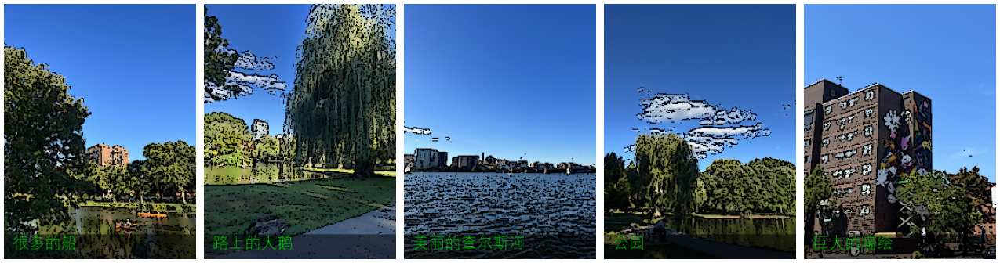

In [174]:
rows_5 = my_simple_row_chinese (
        'group6_images/page3', 
         ['BoatTogether', 'CanadaGoose', 'CharlesRive', 'ManSittingInPublicGarden', 'Paiting'],
         ['pencil', 'pencil', 'buildings', 'buildings', 'buildings'],
         ['很多的船', '路上的大鹅', '美丽的查尔斯河', '公园', '巨大的墙绘'],
         [1, 1, 1, 1, 1]
        )
rows_5_pil = cv2.cvtColor(rows_5, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_5_pil))
rows_5_pil.shape
PIL.Image.fromarray(rows_5_pil).save('3-row5-2-c.png')

group6_images/page3/airport.JPG
Using font dengl...
group6_images/page3/airsky.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/page3/BostonPublicLiabray.JPG
Using font dengl...
group6_images/page3/building.JPG
Using font dengl...


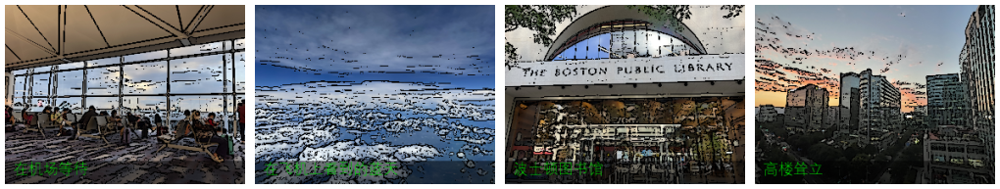

In [175]:
rows_4 = my_simple_row_chinese (
        'group6_images/page3', 
         ['airport', 'airsky', 'BostonPublicLiabray', 'building'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['在机场等待', '在飞机上看到的蓝天', '波士顿图书馆', '高楼耸立'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('3-row4-1-c.png')

group6_images/page3/sunlight.JPG
Using font dengl...
group6_images/page3/target.JPG
Using font dengl...
group6_images/page3/IMG_5345.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/page3/IMG_5349.JPG
Using font dengl...


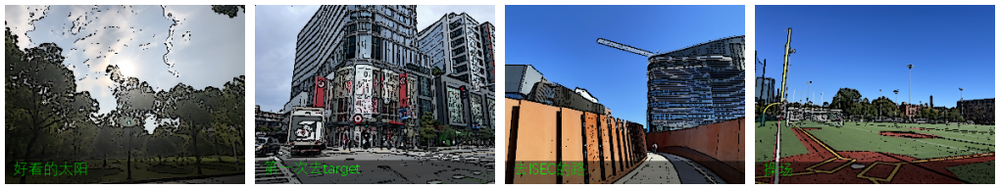

In [176]:
rows_4 = my_simple_row_chinese (
        'group6_images/page3', 
         ['sunlight', 'target', 'IMG_5345', 'IMG_5349'],
         ['pencil', 'pencil', 'buildings', 'buildings'],
         ['好看的太阳', '第一次去target', '去ISEC的路', '操场'],
         [1, 1, 1, 1]
        )
rows_4_pil = cv2.cvtColor(rows_4, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_4_pil))
rows_4_pil.shape
PIL.Image.fromarray(rows_4_pil).save('3-row4-2-c.png')

group6_images/page3/IMG_5340.JPG
Using font dengl...
group6_images/page3/IMG_5328.JPG


/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1759061117.py:35: DeprecationWarning: getsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use getbbox or getlength instead.
  _, h = myfont.getsize(text)


Using font dengl...
group6_images/page3/IMG_5236.JPG
Using font dengl...


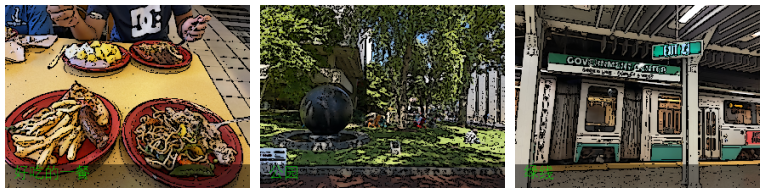

In [177]:
rows_3 = my_simple_row_chinese (
        'group6_images/page3', 
         ['IMG_5340', 'IMG_5328', 'IMG_5236'],
         ['pencil', 'pencil', 'buildings'],
         ['好吃的一餐', '公园', '绿线'],
         [1, 1, 1]
        )
rows_3_pil = cv2.cvtColor(rows_3, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
display(Image.fromarray(rows_3_pil))
rows_3_pil.shape
PIL.Image.fromarray(rows_3_pil).save('3-row3-1-c.png')

/var/folders/06/vtkypm6s2vggv926_2kl6l8r0000gn/T/ipykernel_7062/1099104858.py:11: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )


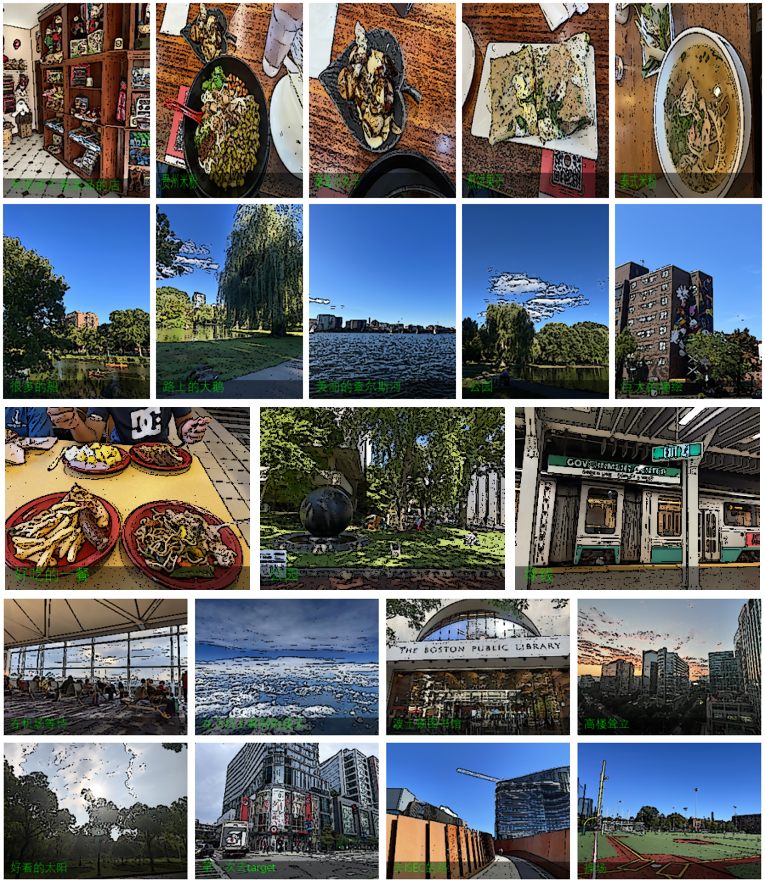

In [178]:
list_im = ['3-row5-1-c.png',
           '3-row5-2-c.png',
           '3-row3-1-c.png',
           '3-row4-1-c.png',
          '3-row4-2-c.png']
imgs    = [ PIL.Image.open(i) for i in list_im ]

# pick the image which is the smallest, and resize the others to match it (can be arbitrary image shape here)
min_shape = sorted( [(np.sum(i.size), i.size ) for i in imgs])[0][1]
shapes = [[min_shape[0], (int)((min_shape[0] / i.size[0]) * i.size[1])] for i in imgs]
imgs_comb = np.vstack( (np.asarray( imgs[i].resize(shapes[i]) ) for i in range(len(imgs)) ) )

# save that beautiful picture
imgs_comb = PIL.Image.fromarray( imgs_comb)
imgs_comb.save( 'page3-c.png' ) 
imgs_comb

## Generate PDF

Generate English version pdf.

In [180]:
from PIL import Image
from fpdf import FPDF

#pdf = FPDF()
cover = Image.open('page1.png')
width, height = cover.size
pdf = FPDF(unit = "pt", format = [width, height])

# imagelist is the list with all image filenames
imagelist = ['page1.png', 'page2.png', 'page3.png']

for image in imagelist:
    pdf.add_page()
    pdf.image(image, 0, 0, width, height)
pdf.output("storybook.pdf", "F")
print("done!")

done!


Generate Chinese version pdf.

In [179]:
from PIL import Image
from fpdf import FPDF

#pdf = FPDF()
cover = Image.open('page1.png')
width, height = cover.size
pdf = FPDF(unit = "pt", format = [width, height])

# imagelist is the list with all image filenames
imagelist = ['page1-c.png', 'page2-c.png', 'page3-c.png']

for image in imagelist:
    pdf.add_page()
    pdf.image(image, 0, 0, width, height)
pdf.output("storybook_chinese.pdf", "F")
print("done!")

done!
